Copyright 2020 DeepMind Technologies Limited

Licensed under the Apache License, Version 2.0 (the "License");
you may not use this file except in compliance with the License.
You may obtain a copy of the License at

     https://www.apache.org/licenses/LICENSE-2.0

Unless required by applicable law or agreed to in writing, software
distributed under the License is distributed on an "AS IS" BASIS,
WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
See the License for the specific language governing permissions and
limitations under the License.

## Clone repo and import dependencies

In [1]:
from platform import python_version

print(python_version())

3.7.16


In [2]:

import os
import numpy as np
import tensorflow.compat.v1 as tf
tf.logging.set_verbosity(tf.logging.ERROR)  # Hide TF deprecation messages
%cd /Users/wuyulong/projects/Polygen/tmp/deepmind_research/polygen
import modules
import data_utils

C:\Users\wuyulong\projects\Polygen\tmp\deepmind_research\polygen


## Prepare a synthetic dataset
We prepare a dataset of meshes using four simple geometric primitives.

The important function here is `data_utils.load_process_mesh`, which loads the raw `.obj` file, normalizes and centers the meshes, and applies quantization to the vertex positions. The mesh faces are flattened and treated as a long sequence, with a new-face token (`=1`) separating the faces. For each of the four synthetic meshes, we associate a unique class label, so we can train class-conditional models.

After processing the raw mesh data into numpy arrays, we create a `tf.data.Dataset` that we can use to feed data to our models. 

{'vertices': array([[ 53,  53,  53],
       [201,  53,  53],
       [ 53, 201,  53],
       [201, 201,  53],
       [ 53,  53, 201],
       [201,  53, 201],
       [ 53, 201, 201],
       [201, 201, 201]]), 'faces': array([2, 4, 5, 3, 1, 2, 6, 7, 3, 1, 2, 6, 8, 4, 1, 3, 7, 9, 5, 1, 4, 8,
       9, 5, 1, 6, 8, 9, 7, 0]), 'class_label': 0}


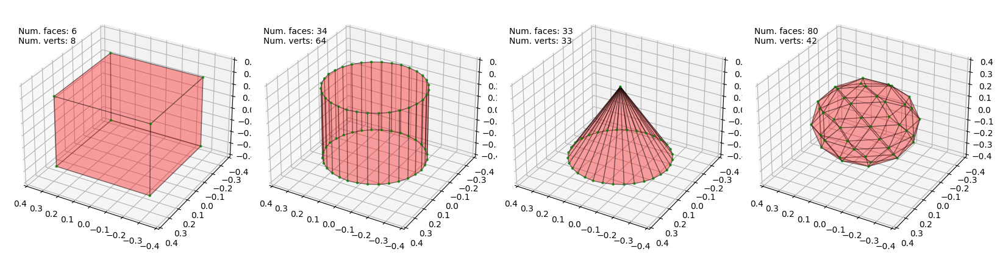

In [3]:
# Prepare synthetic dataset
ex_list = []
for k, mesh in enumerate(['cube', 'cylinder', 'cone', 'icosphere']):
  mesh_dict = data_utils.load_process_mesh(
      os.path.join('meshes', '{}.obj'.format(mesh)))
  mesh_dict['class_label'] = k
  ex_list.append(mesh_dict)
synthetic_dataset = tf.data.Dataset.from_generator(
    lambda: ex_list, 
    output_types={
        'vertices': tf.int32, 'faces': tf.int32, 'class_label': tf.int32},
    output_shapes={
        'vertices': tf.TensorShape([None, 3]), 'faces': tf.TensorShape([None]), 
        'class_label': tf.TensorShape(())}
    )
ex = synthetic_dataset.make_one_shot_iterator().get_next()

# Inspect the first mesh
with tf.Session() as sess:
  ex_np = sess.run(ex)
print(ex_np)

# Plot the meshes
mesh_list = []
with tf.Session() as sess:
  for i in range(4):
    ex_np = sess.run(ex)
    mesh_list.append(
        {'vertices': data_utils.dequantize_verts(ex_np['vertices']), 
         'faces': data_utils.unflatten_faces(ex_np['faces'])})
data_utils.plot_meshes(mesh_list, ax_lims=0.4)

## Vertex model

#### Prepare the dataset for vertex model training
We need to perform some additional processing to make the dataset ready for vertex model training. In particular, `data_utils.make_vertex_model_dataset` flattens the `[V, 3]` vertex arrays, ordering by `Z->Y->X` coordinates. It also creates masks, which are used to mask padded elements in data batches. We also add random shifts to make the modelling task more challenging.

#### Create a vertex model
`modules.VertexModel` is a Sonnet module that. Calling the module on a batch of data will produce outputs which are the sequential predictions for each vertex coordinate. The basis of the vertex model is a Transformer decoder, and we specify it's parameters in `decoder_config`. 



In [4]:
# Prepare the dataset for vertex model training
vertex_model_dataset = data_utils.make_vertex_model_dataset(
    synthetic_dataset, apply_random_shift=False)
vertex_model_dataset = vertex_model_dataset.repeat()
vertex_model_dataset = vertex_model_dataset.padded_batch(
    4, padded_shapes=vertex_model_dataset.output_shapes)
vertex_model_dataset = vertex_model_dataset.prefetch(1)
vertex_model_batch = vertex_model_dataset.make_one_shot_iterator().get_next()

# Create vertex model
vertex_model = modules.VertexModel(
    decoder_config={
        'hidden_size': 128,
        'fc_size': 512, 
        'num_layers': 3,
        'dropout_rate': 0.
    },
    class_conditional=True,
    num_classes=4,
    max_num_input_verts=250,
    quantization_bits=8,
)
vertex_model_pred_dist = vertex_model(vertex_model_batch)
vertex_model_loss = -tf.reduce_sum(
    vertex_model_pred_dist.log_prob(vertex_model_batch['vertices_flat']) * 
    vertex_model_batch['vertices_flat_mask'])
vertex_samples = vertex_model.sample(
    4, context=vertex_model_batch, max_sample_length=200, top_p=0.95,
    recenter_verts=False, only_return_complete=False)

print(vertex_model_batch)
print(vertex_model_pred_dist)
print(vertex_samples)

{'vertices': <tf.Tensor 'IteratorGetNext_1:2' shape=(?, ?, 3) dtype=int32>, 'faces': <tf.Tensor 'IteratorGetNext_1:1' shape=(?, ?) dtype=int32>, 'class_label': <tf.Tensor 'IteratorGetNext_1:0' shape=(?,) dtype=int32>, 'vertices_flat': <tf.Tensor 'IteratorGetNext_1:3' shape=(?, ?) dtype=int32>, 'vertices_flat_mask': <tf.Tensor 'IteratorGetNext_1:4' shape=(?, ?) dtype=float32>}
tfp.distributions.Categorical("vertex_model_1_vertex_model_create_dist_Categorical", batch_shape=[?, ?], event_shape=[], dtype=int32)
{'completed': <tf.Tensor 'Any:0' shape=(?,) dtype=bool>, 'vertices': <tf.Tensor 'mul_4:0' shape=(?, 200, 3) dtype=float32>, 'num_vertices': <tf.Tensor 'floordiv:0' shape=(?,) dtype=int32>, 'vertices_mask': <tf.Tensor 'Cast_2:0' shape=(?, 200) dtype=float32>}


## Face model

#### Prepare the dataset for face model training
We need to perform some additional processing to make the dataset ready for vertex model training. In particular, `data_utils.make_vertex_model_dataset` flattens the `[V, 3]` vertex arrays, ordering by `Z->Y->X` coordinates. It also creates masks, which are used to mask padded elements in data batches. We also add random shifts to make the modelling task more challenging.

#### Create a face model
`modules.VertexModel` is a Sonnet module that. Calling the module on a batch of data will produce outputs which are the sequential predictions for each vertex coordinate. The basis of the vertex model is a Transformer decoder, and we specify it's parameters in `decoder_config`. 

In [5]:
face_model_dataset = data_utils.make_face_model_dataset(
    synthetic_dataset, apply_random_shift=False)
face_model_dataset = face_model_dataset.repeat()
face_model_dataset = face_model_dataset.padded_batch(
    4, padded_shapes=face_model_dataset.output_shapes)
face_model_dataset = face_model_dataset.prefetch(1)
face_model_batch = face_model_dataset.make_one_shot_iterator().get_next()

# Create face model
face_model = modules.FaceModel(
    encoder_config={
        'hidden_size': 128,
        'fc_size': 512, 
        'num_layers': 3,
        'dropout_rate': 0.
    },
    decoder_config={
        'hidden_size': 128,
        'fc_size': 512, 
        'num_layers': 3,
        'dropout_rate': 0.
    },
    class_conditional=False,
    max_seq_length=500,
    quantization_bits=8,
    decoder_cross_attention=True,
    use_discrete_vertex_embeddings=True,
)
face_model_pred_dist = face_model(face_model_batch)
face_model_loss = -tf.reduce_sum(
    face_model_pred_dist.log_prob(face_model_batch['faces']) * 
    face_model_batch['faces_mask'])
face_samples = face_model.sample(
    context=vertex_samples, max_sample_length=500, top_p=0.95,
    only_return_complete=False)
print(face_model_batch)
print(face_model_pred_dist)
print(face_samples)

{'vertices': <tf.Tensor 'IteratorGetNext_2:4' shape=(?, ?, 3) dtype=float32>, 'faces': <tf.Tensor 'IteratorGetNext_2:1' shape=(?, ?) dtype=int64>, 'class_label': <tf.Tensor 'IteratorGetNext_2:0' shape=(?,) dtype=int32>, 'num_vertices': <tf.Tensor 'IteratorGetNext_2:3' shape=(?,) dtype=int32>, 'vertices_mask': <tf.Tensor 'IteratorGetNext_2:5' shape=(?, ?) dtype=float32>, 'faces_mask': <tf.Tensor 'IteratorGetNext_2:2' shape=(?, ?) dtype=float32>}
tfp.distributions.Categorical("face_model_1_face_model_create_dist_Categorical", batch_shape=[?, ?], event_shape=[], dtype=int32)
{'context': {'completed': <tf.Tensor 'Any:0' shape=(?,) dtype=bool>, 'vertices': <tf.Tensor 'mul_4:0' shape=(?, 200, 3) dtype=float32>, 'num_vertices': <tf.Tensor 'floordiv:0' shape=(?,) dtype=int32>, 'vertices_mask': <tf.Tensor 'Cast_2:0' shape=(?, 200) dtype=float32>}, 'completed': <tf.Tensor 'Any_1:0' shape=(?,) dtype=bool>, 'faces': <tf.Tensor 'Pad_1:0' shape=(?, ?) dtype=int32>, 'num_face_indices': <tf.Tensor 'ad

## Train on the synthetic data

Now that we've created vertex and face models and their respective data loaders, we can train them and look at some outputs. While we train the models together here, they can be trained seperately and recombined later if required. 

Step 0
Loss (vertices) 2469.337646484375
Loss (faces) 2799.2890625


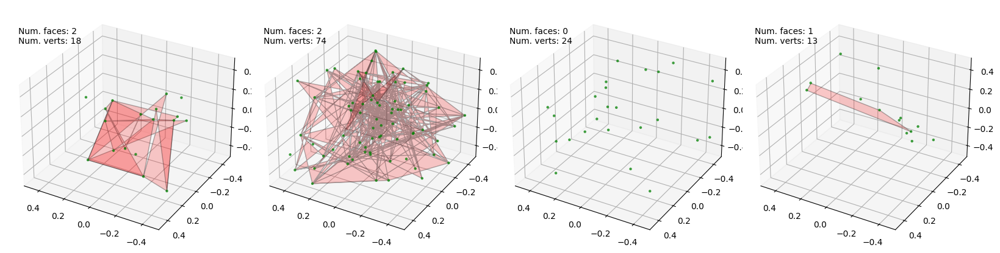

Step 5
Loss (vertices) 2364.038330078125
Loss (faces) 2650.3798828125


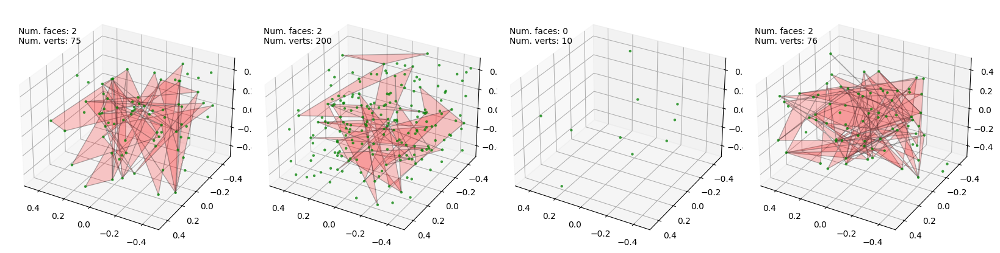

Step 10
Loss (vertices) 2229.15478515625
Loss (faces) 2469.98779296875


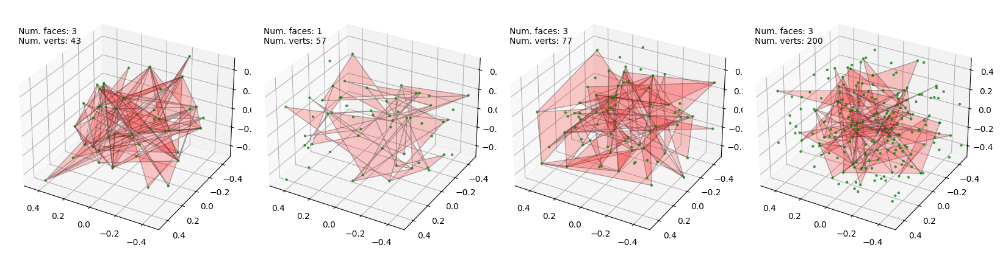

Step 15
Loss (vertices) 2033.439208984375
Loss (faces) 2378.568359375


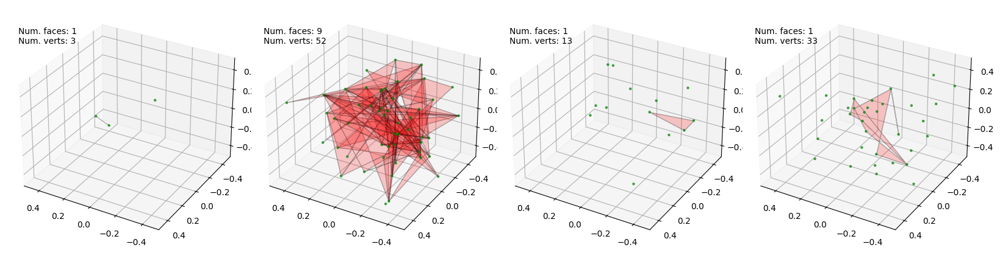

Step 20
Loss (vertices) 1799.1710205078125
Loss (faces) 2255.127197265625


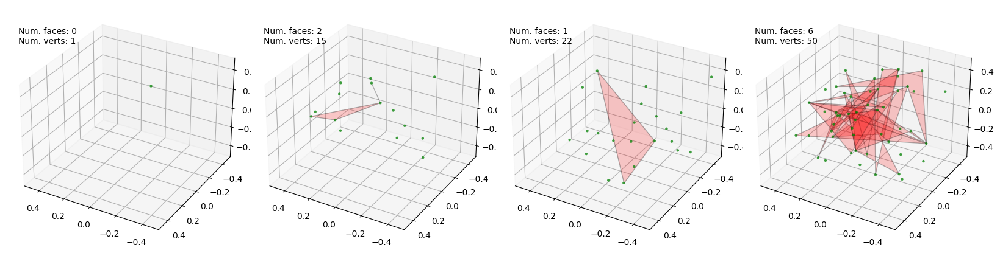

Step 25
Loss (vertices) 1628.65869140625
Loss (faces) 2161.1552734375


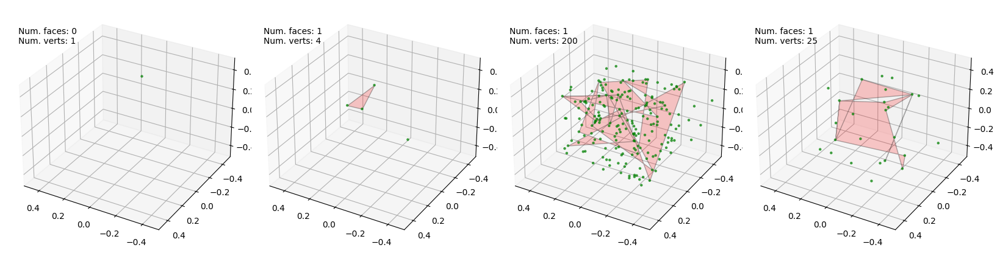

Step 30
Loss (vertices) 1518.201171875
Loss (faces) 2038.3251953125


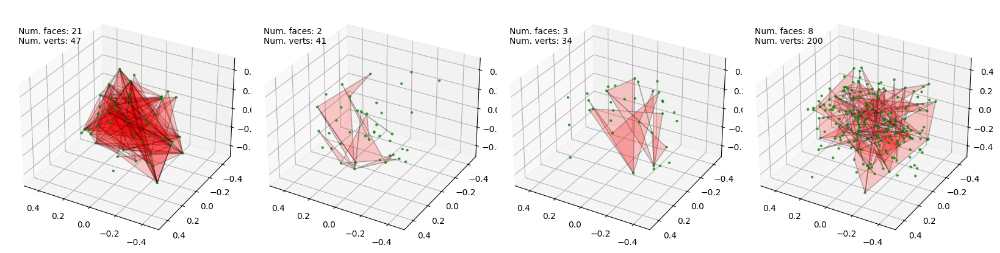

Step 35
Loss (vertices) 1432.0810546875
Loss (faces) 1900.440185546875


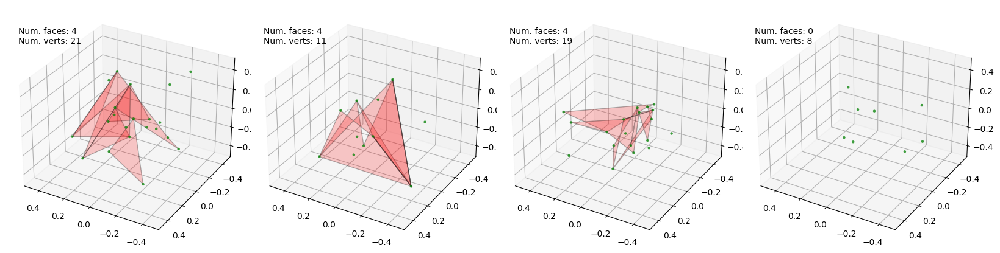

Step 40
Loss (vertices) 1350.8447265625
Loss (faces) 1759.7357177734375


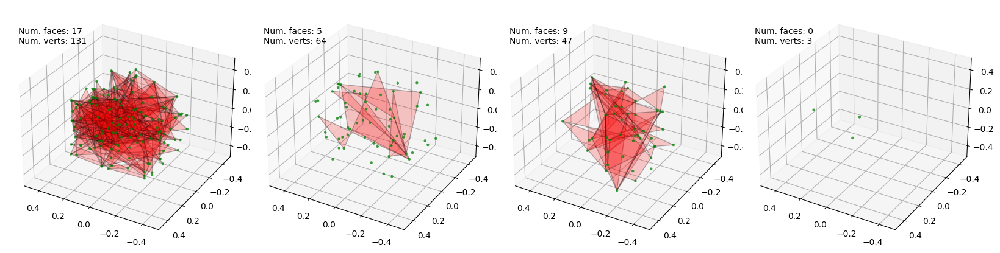

Step 45
Loss (vertices) 1271.84326171875
Loss (faces) 1615.67041015625


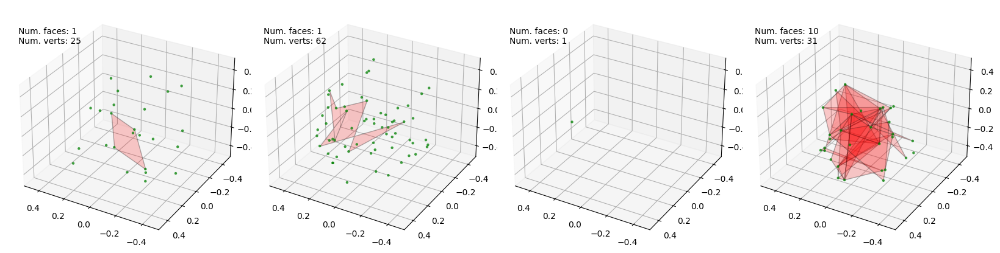

Step 50
Loss (vertices) 1187.98486328125
Loss (faces) 1458.394775390625


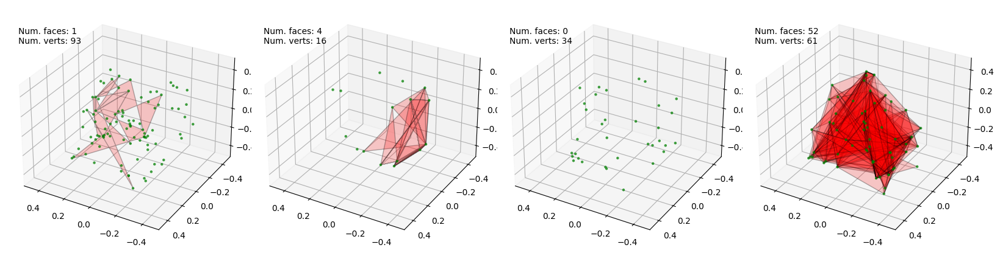

Step 55
Loss (vertices) 1097.68359375
Loss (faces) 1300.5465087890625


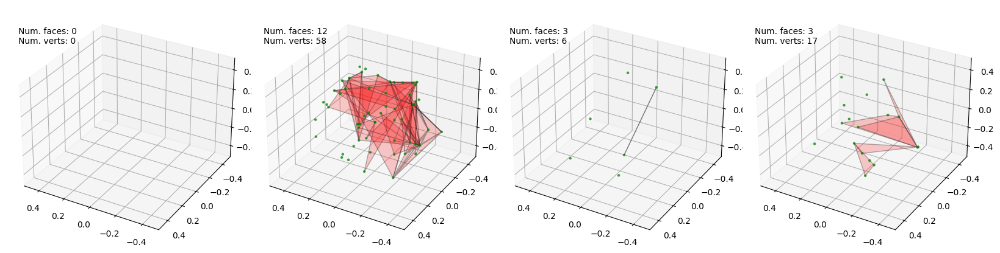

Step 60
Loss (vertices) 1018.1157836914062
Loss (faces) 1177.875244140625


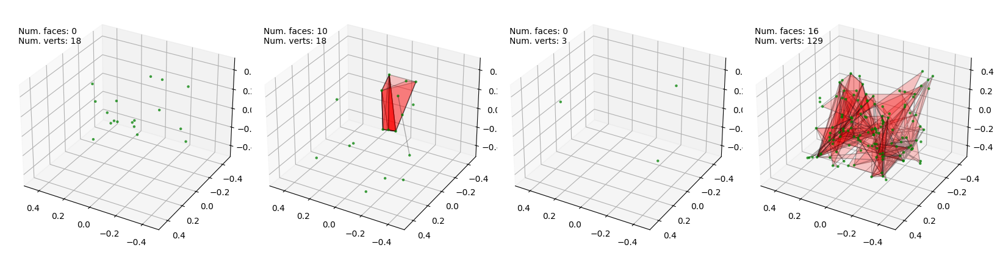

Step 65
Loss (vertices) 946.1510620117188
Loss (faces) 1051.25146484375


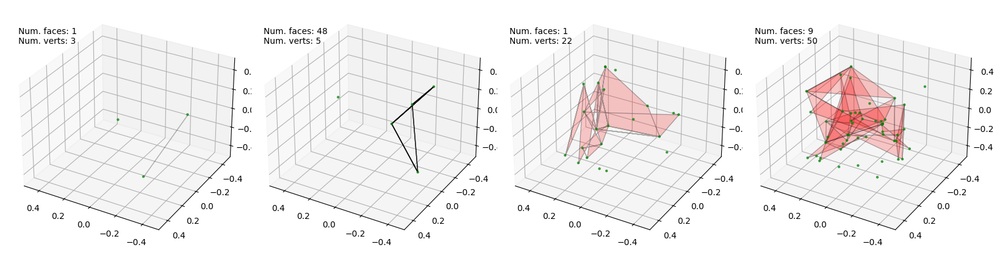

Step 70
Loss (vertices) 875.5491943359375
Loss (faces) 927.0317993164062


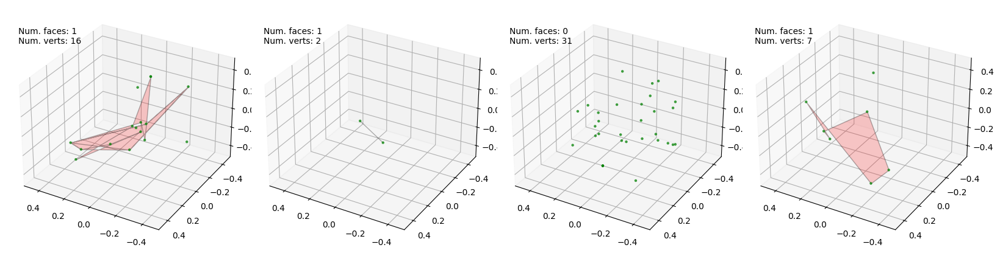

Step 75
Loss (vertices) 798.0855712890625
Loss (faces) 804.6488037109375


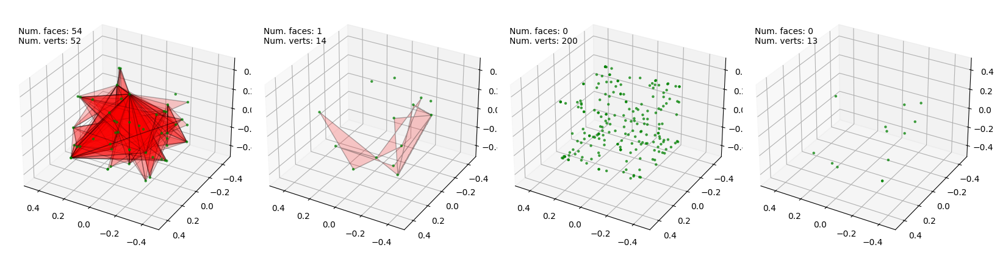

Step 80
Loss (vertices) 708.6707763671875
Loss (faces) 763.097900390625


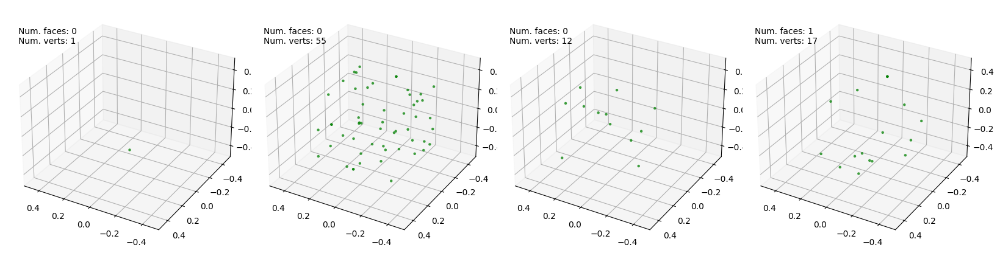

Step 85
Loss (vertices) 615.8614501953125
Loss (faces) 690.8135986328125


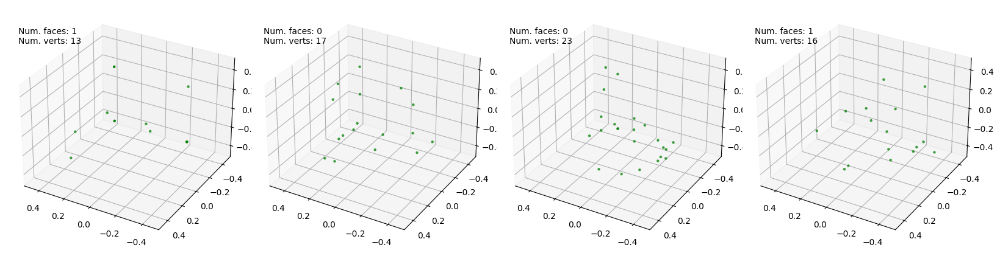

Step 90
Loss (vertices) 529.097412109375
Loss (faces) 586.4957275390625


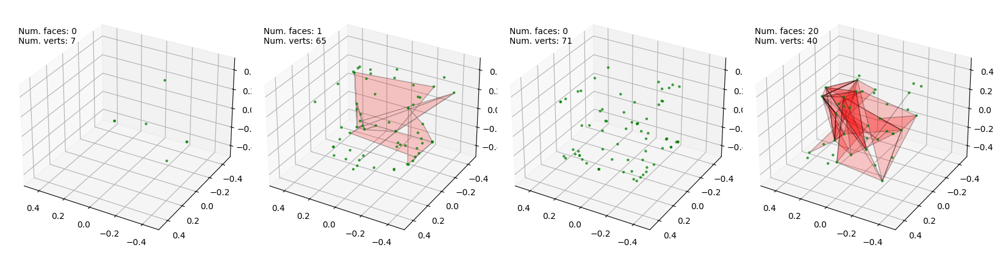

Step 95
Loss (vertices) 447.3592529296875
Loss (faces) 512.6785278320312


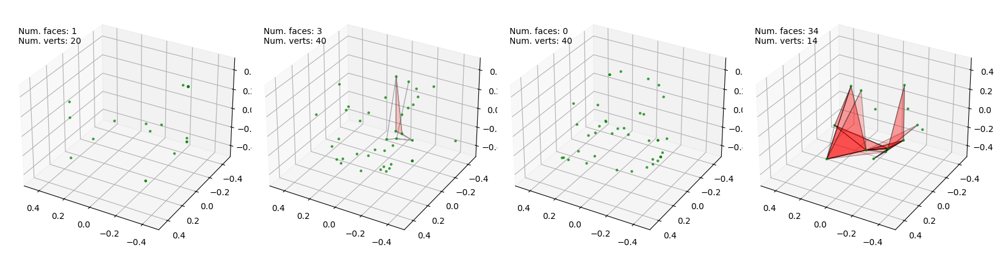

Step 100
Loss (vertices) 372.5841064453125
Loss (faces) 432.70562744140625


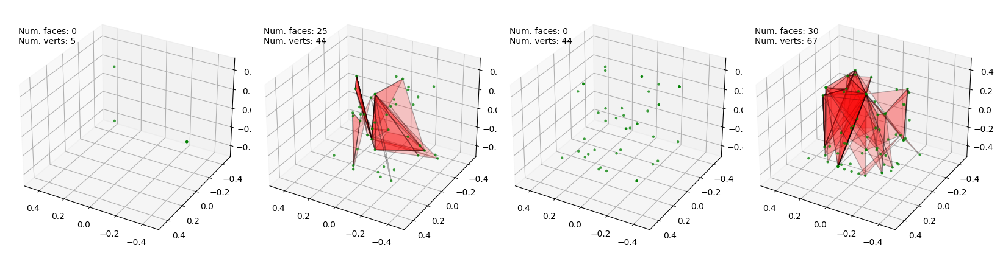

Step 105
Loss (vertices) 309.77581787109375
Loss (faces) 370.2927551269531


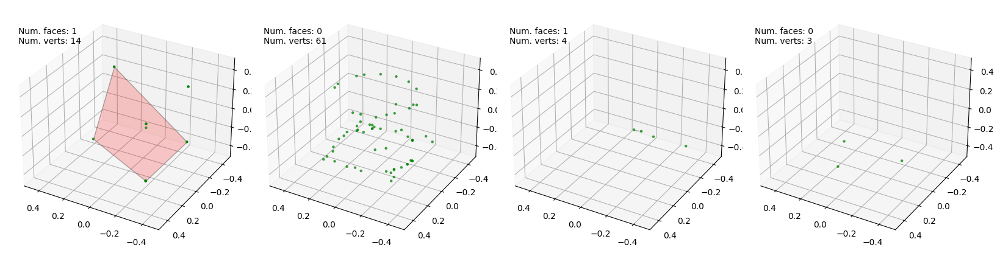

Step 110
Loss (vertices) 259.5542297363281
Loss (faces) 312.093994140625


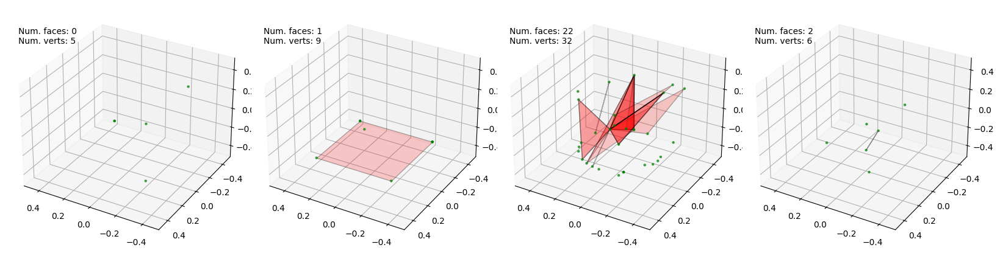

Step 115
Loss (vertices) 219.525634765625
Loss (faces) 266.44085693359375


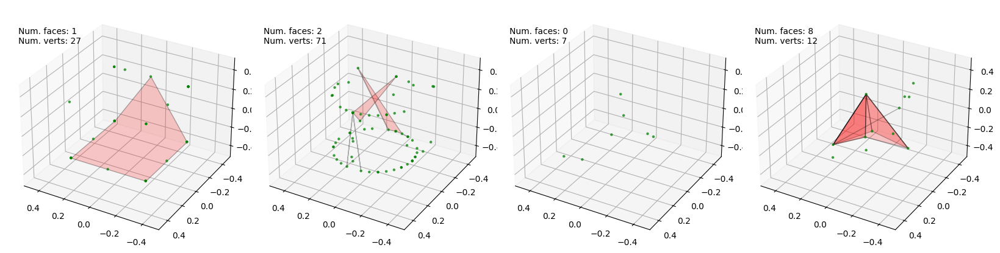

Step 120
Loss (vertices) 188.14015197753906
Loss (faces) 223.9852294921875


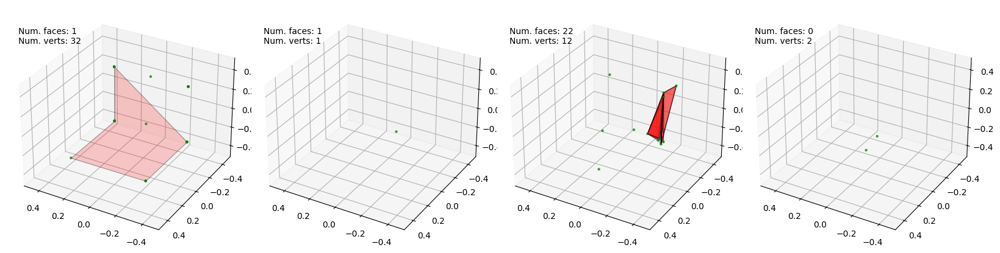

Step 125
Loss (vertices) 163.452392578125
Loss (faces) 188.3269805908203


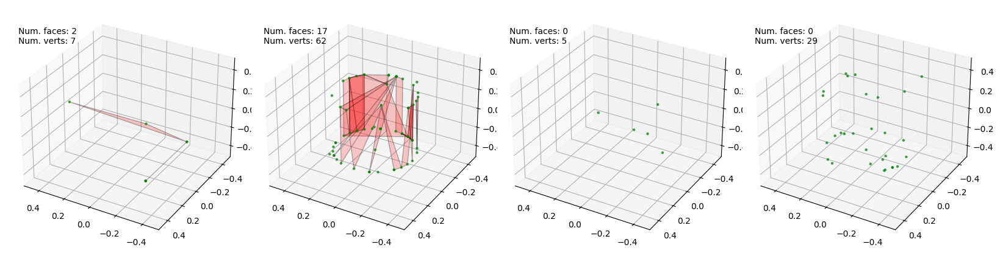

Step 130
Loss (vertices) 143.86129760742188
Loss (faces) 156.58685302734375


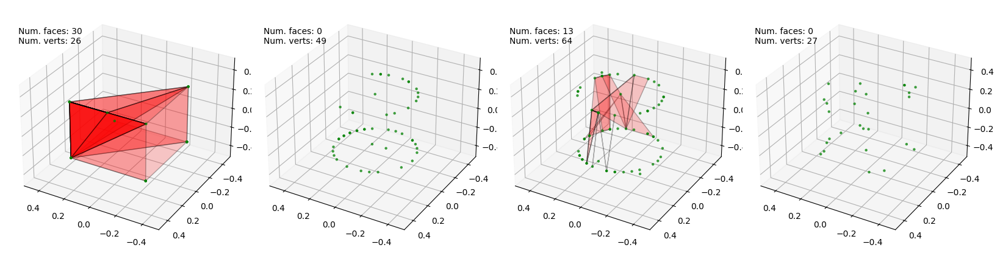

Step 135
Loss (vertices) 127.95693969726562
Loss (faces) 129.75286865234375


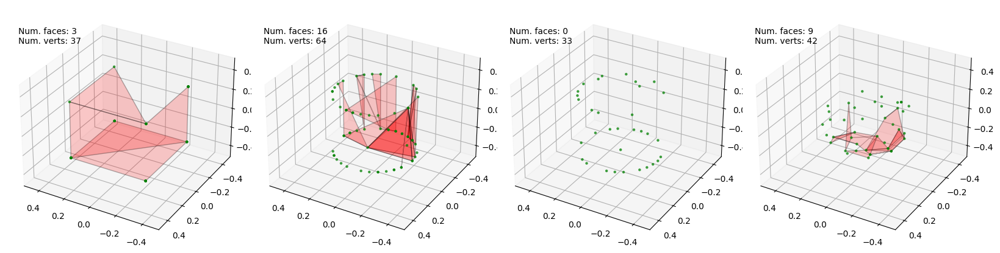

Step 140
Loss (vertices) 112.88125610351562
Loss (faces) 106.45740509033203


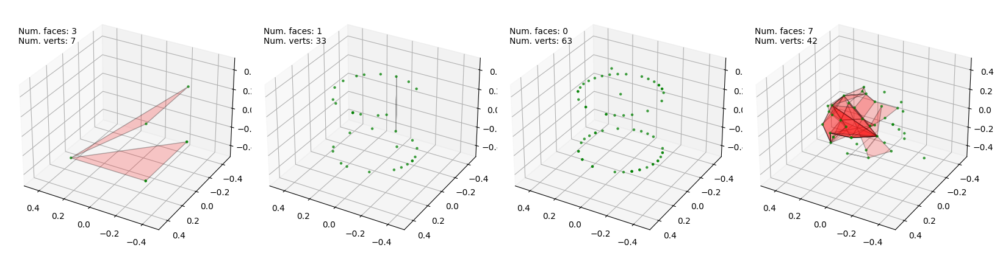

Step 145
Loss (vertices) 96.05477142333984
Loss (faces) 86.93498229980469


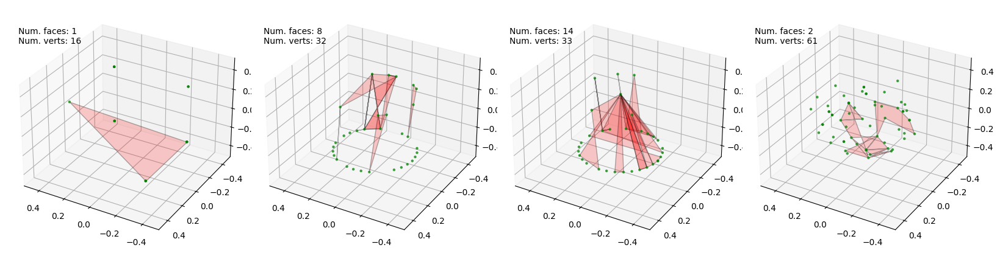

Step 150
Loss (vertices) 78.90570831298828
Loss (faces) 70.61135864257812


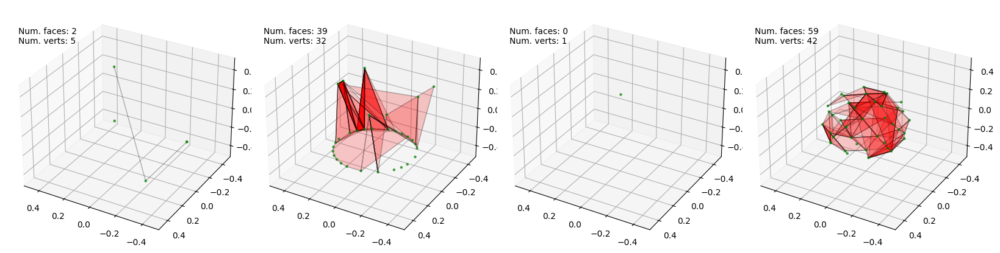

Step 155
Loss (vertices) 63.864994049072266
Loss (faces) 57.12885284423828


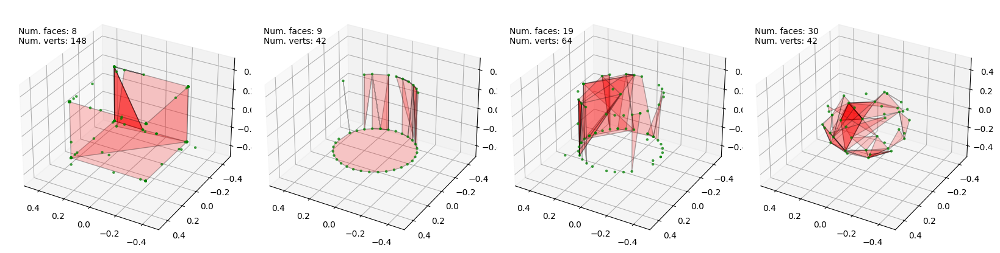

Step 160
Loss (vertices) 50.36787796020508
Loss (faces) 45.95731735229492


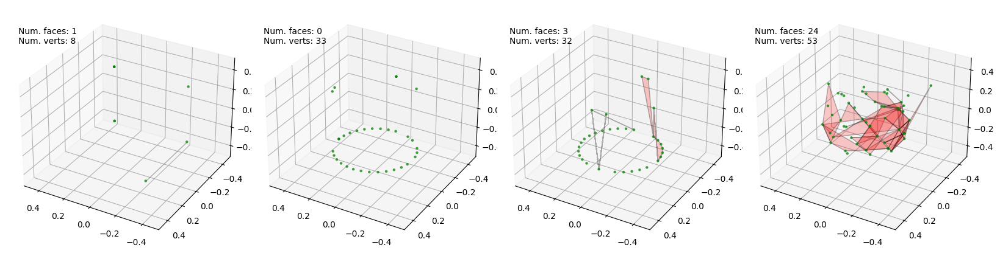

Step 165
Loss (vertices) 38.594425201416016
Loss (faces) 37.09175109863281


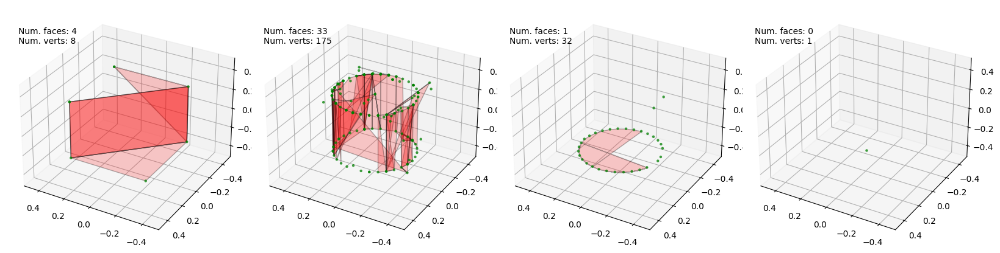

Step 170
Loss (vertices) 33.19755554199219
Loss (faces) 30.165929794311523


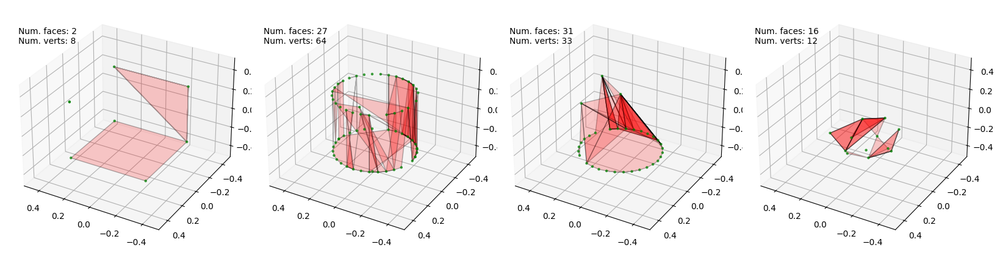

Step 175
Loss (vertices) 25.65264892578125
Loss (faces) 24.9086856842041


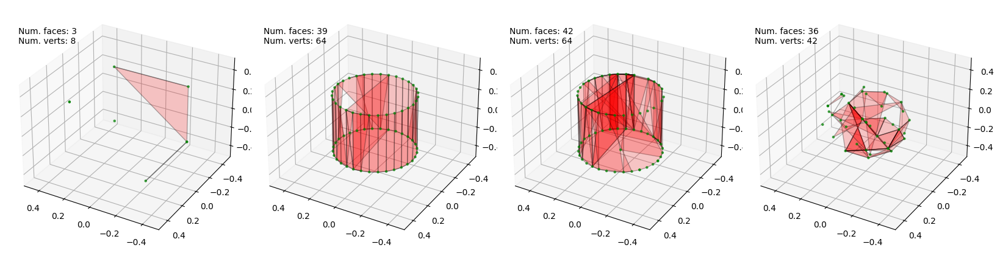

Step 180
Loss (vertices) 20.387981414794922
Loss (faces) 20.801162719726562


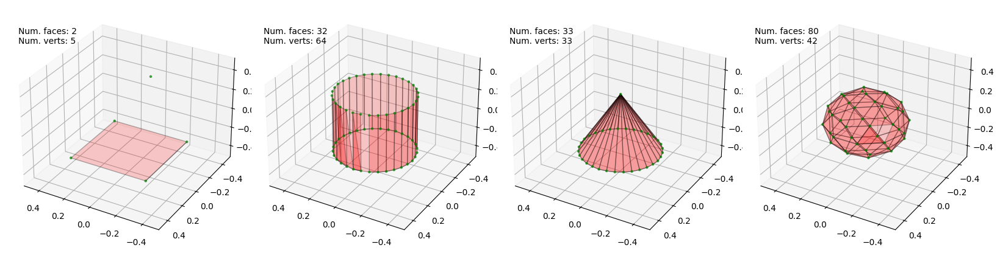

Step 185
Loss (vertices) 16.74942398071289
Loss (faces) 17.60708999633789


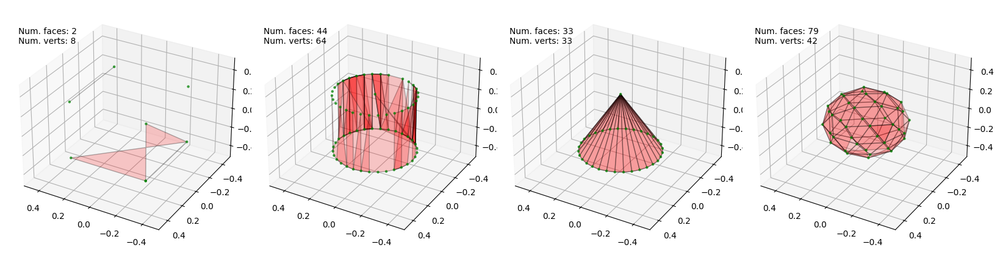

Step 190
Loss (vertices) 14.282947540283203
Loss (faces) 15.090575218200684


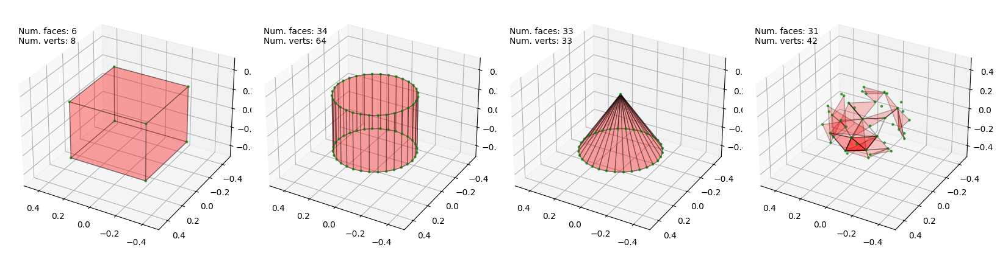

Step 195
Loss (vertices) 12.509864807128906
Loss (faces) 13.07628059387207


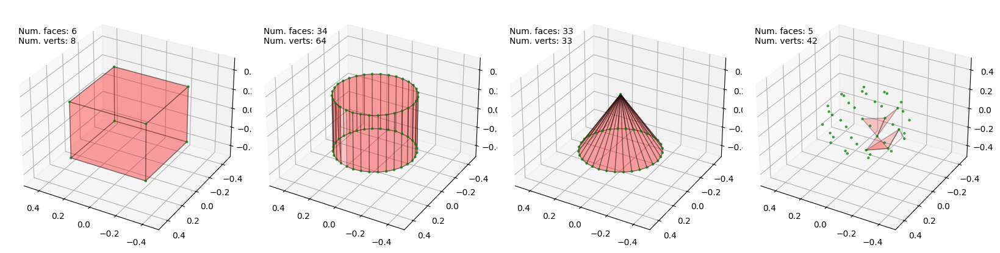

Step 200
Loss (vertices) 11.18057632446289
Loss (faces) 11.465778350830078


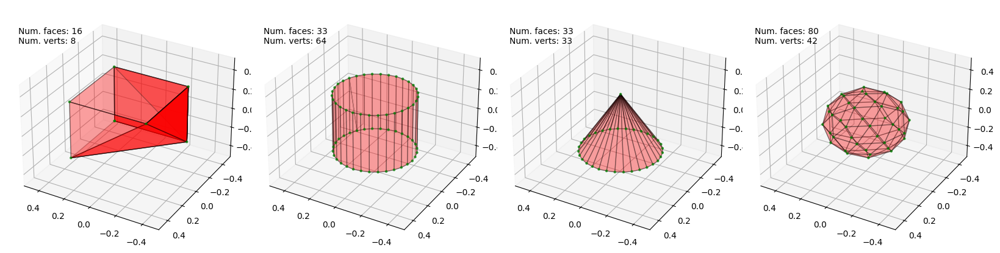

Step 205
Loss (vertices) 10.159088134765625
Loss (faces) 10.161018371582031


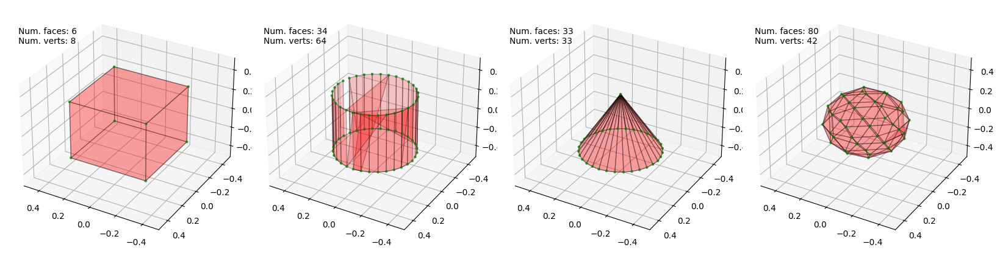

Step 210
Loss (vertices) 9.340532302856445
Loss (faces) 9.101669311523438


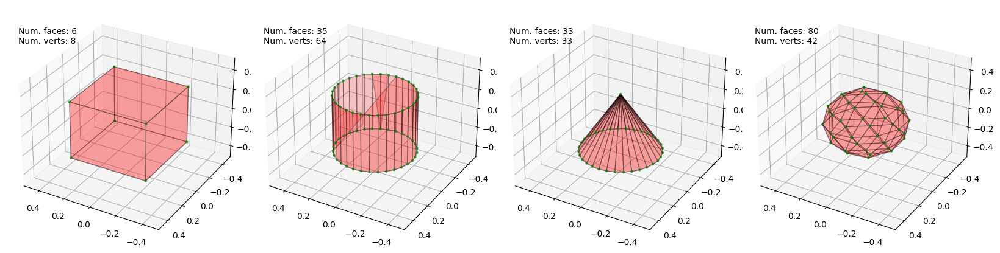

Step 215
Loss (vertices) 8.667680740356445
Loss (faces) 8.230891227722168


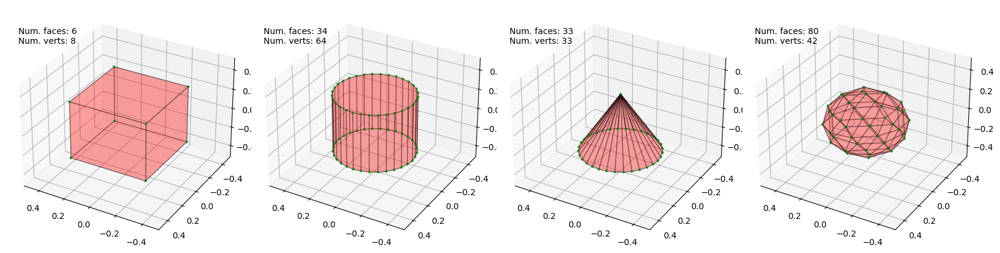

Step 220
Loss (vertices) 8.100824356079102
Loss (faces) 7.496545791625977


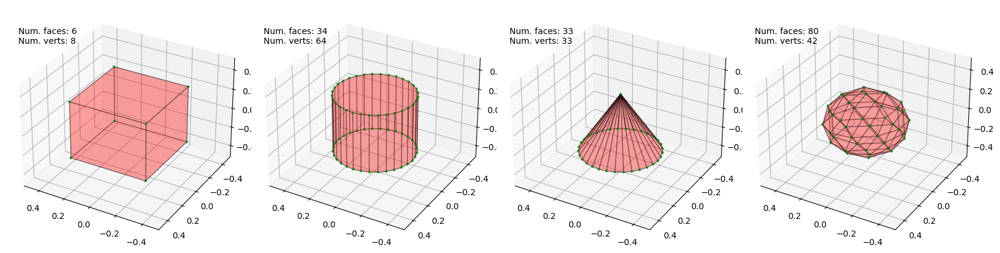

Step 225
Loss (vertices) 7.612130165100098
Loss (faces) 6.878017902374268


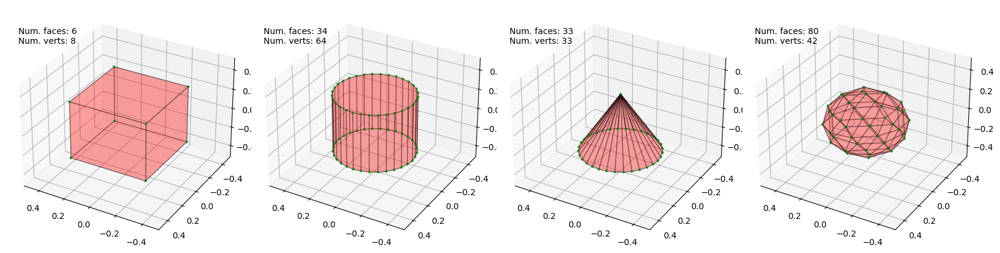

Step 230
Loss (vertices) 7.185532569885254
Loss (faces) 6.3446197509765625


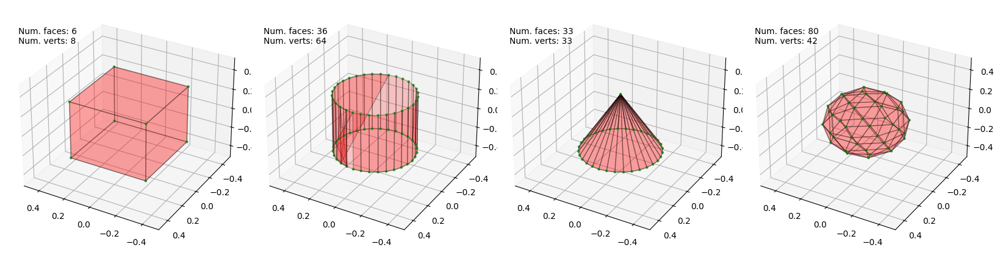

Step 235
Loss (vertices) 6.807807922363281
Loss (faces) 5.880942344665527


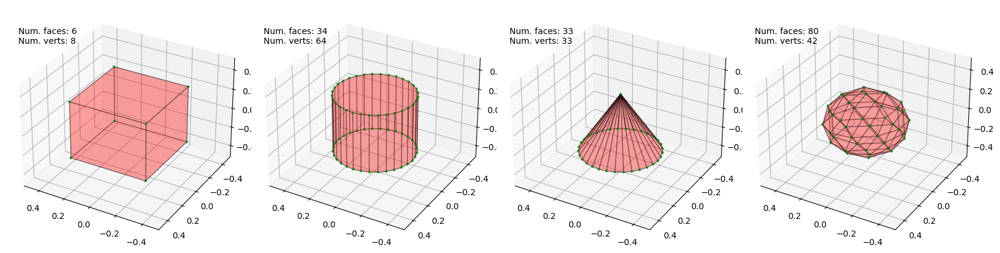

Step 240
Loss (vertices) 6.469330787658691
Loss (faces) 5.475364685058594


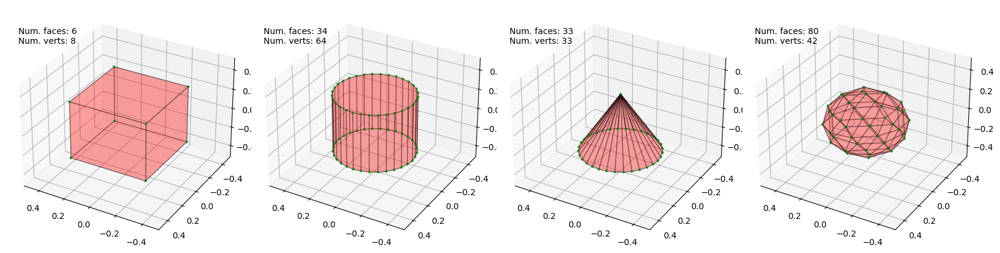

Step 245
Loss (vertices) 6.163815498352051
Loss (faces) 5.117575168609619


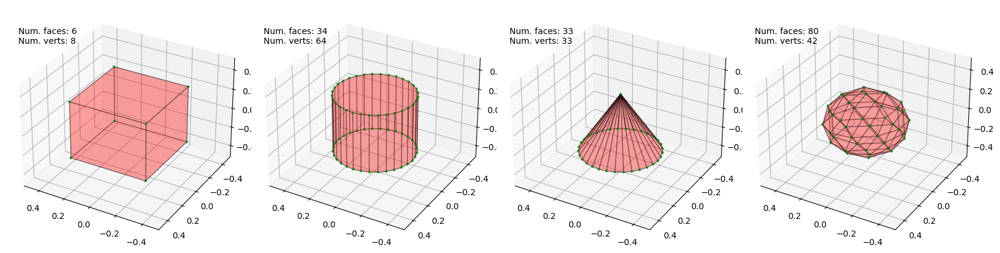

Step 250
Loss (vertices) 5.885876655578613
Loss (faces) 4.799211502075195


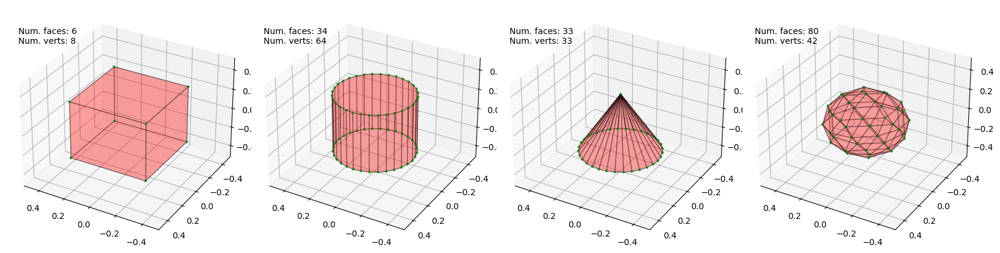

Step 255
Loss (vertices) 5.631570816040039
Loss (faces) 4.514191627502441


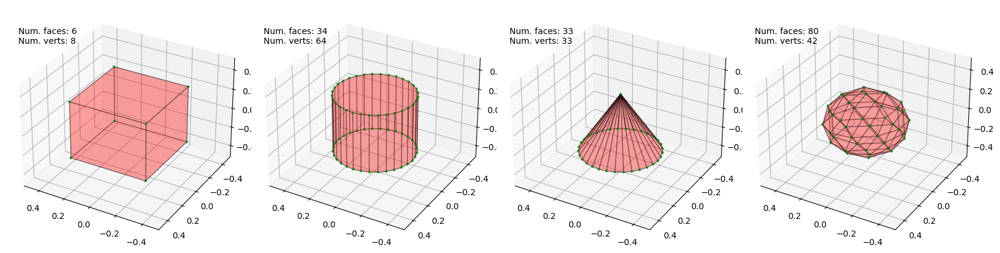

Step 260
Loss (vertices) 5.397680759429932
Loss (faces) 4.257790565490723


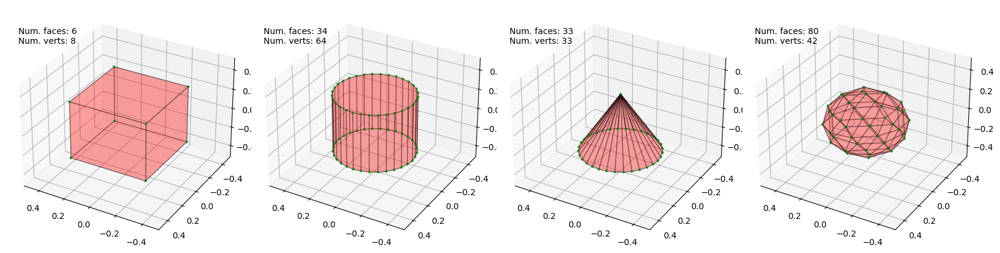

Step 265
Loss (vertices) 5.181349754333496
Loss (faces) 4.0261006355285645


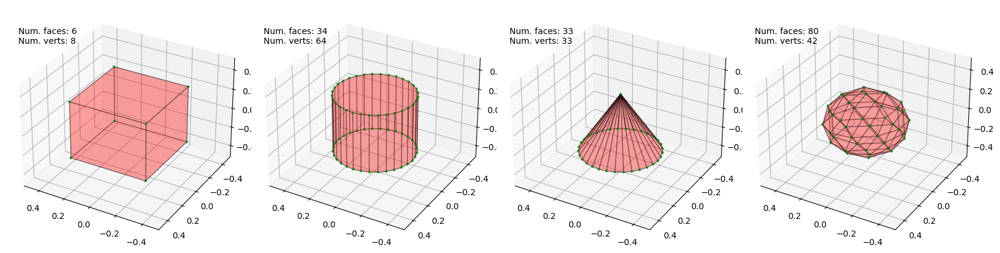

Step 270
Loss (vertices) 4.980901718139648
Loss (faces) 3.815734386444092


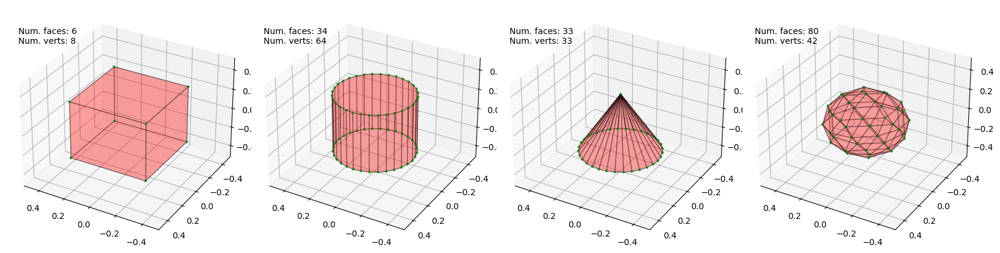

Step 275
Loss (vertices) 4.79448938369751
Loss (faces) 3.623955249786377


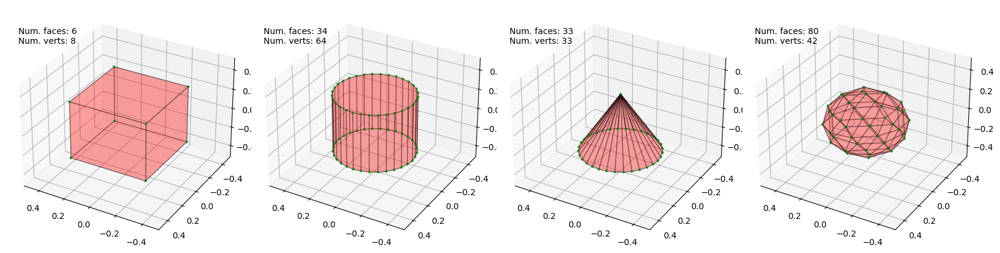

Step 280
Loss (vertices) 4.620291709899902
Loss (faces) 3.448489189147949


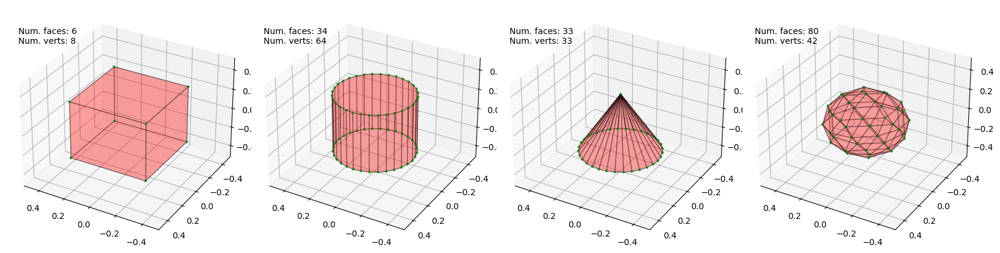

Step 285
Loss (vertices) 4.457483291625977
Loss (faces) 3.2873857021331787


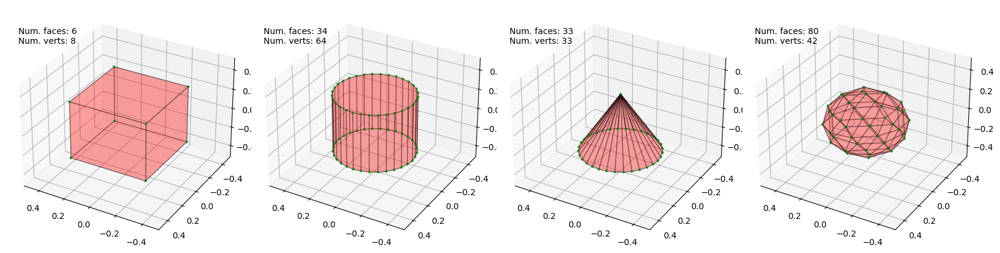

Step 290
Loss (vertices) 4.304643630981445
Loss (faces) 3.1389646530151367


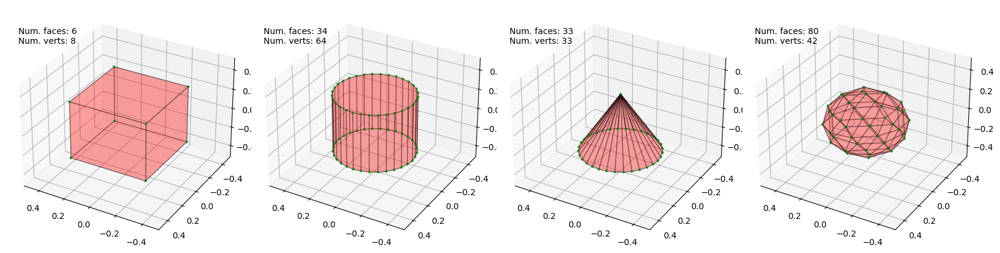

Step 295
Loss (vertices) 4.1608991622924805
Loss (faces) 3.001835823059082


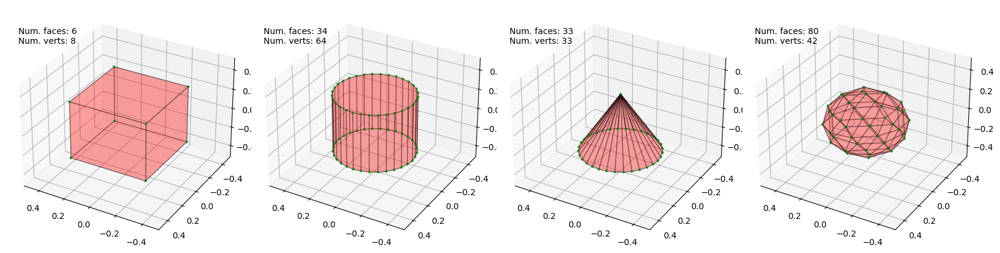

Step 300
Loss (vertices) 4.025737762451172
Loss (faces) 2.874785900115967


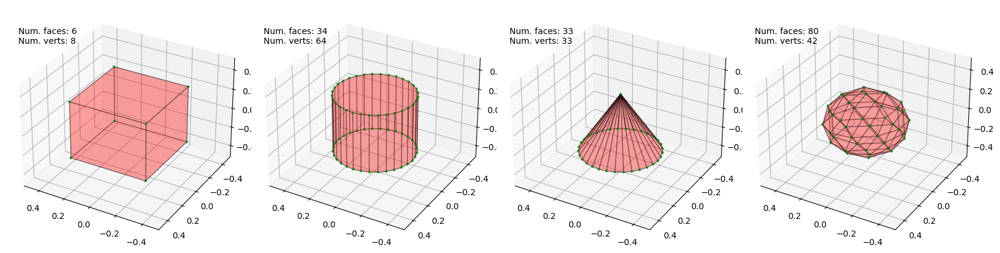

Step 305
Loss (vertices) 3.898110866546631
Loss (faces) 2.75675368309021


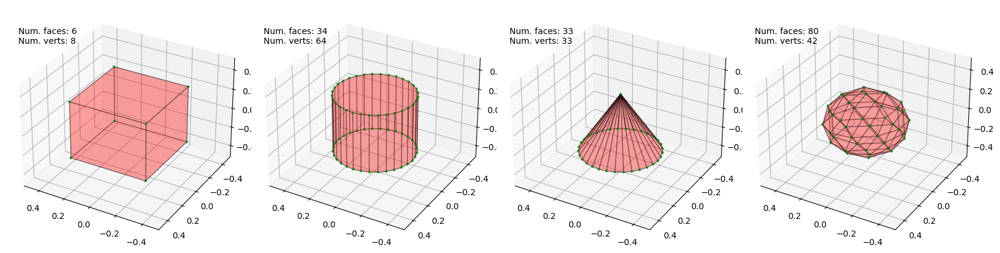

Step 310
Loss (vertices) 3.777535915374756
Loss (faces) 2.646857261657715


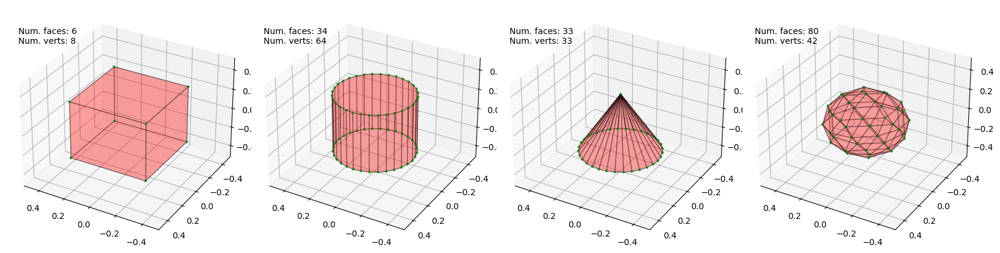

Step 315
Loss (vertices) 3.663228988647461
Loss (faces) 2.544314384460449


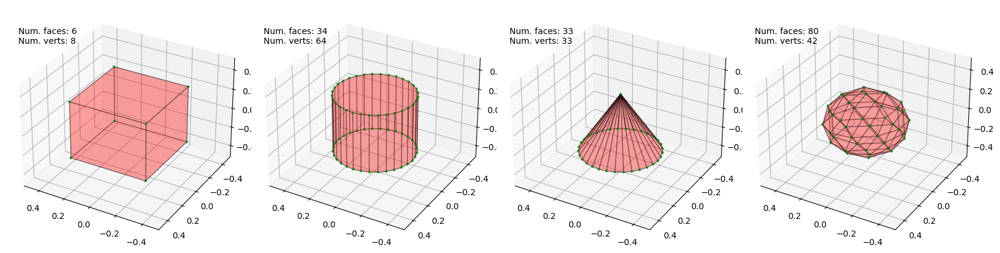

Step 320
Loss (vertices) 3.554908037185669
Loss (faces) 2.4484217166900635


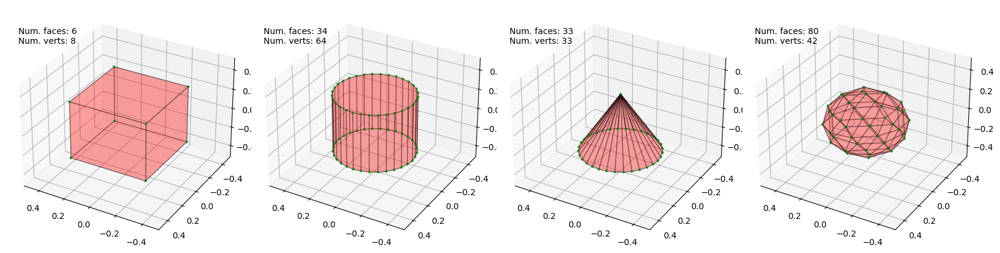

Step 325
Loss (vertices) 3.452146053314209
Loss (faces) 2.358579635620117


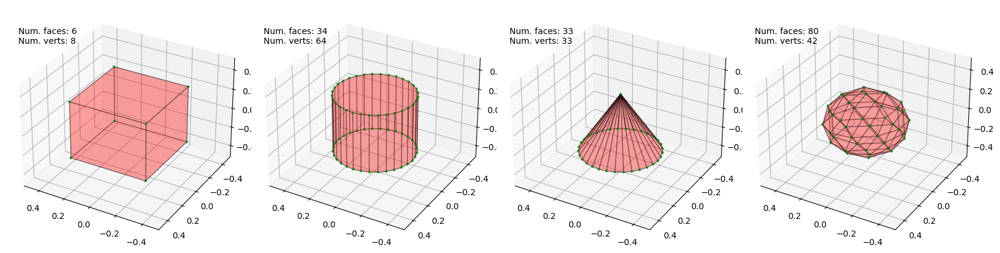

Step 330
Loss (vertices) 3.354539155960083
Loss (faces) 2.274260997772217


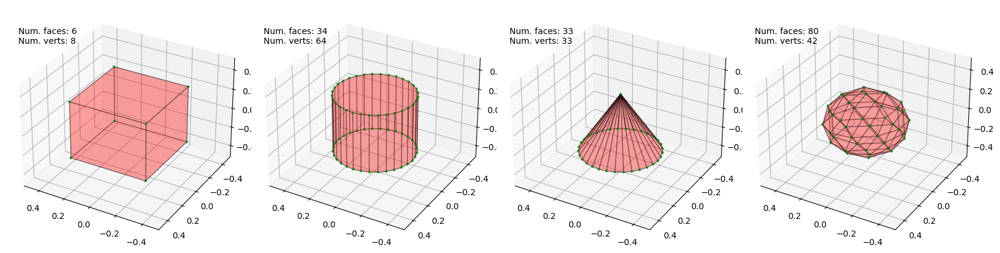

Step 335
Loss (vertices) 3.261547565460205
Loss (faces) 2.1949663162231445


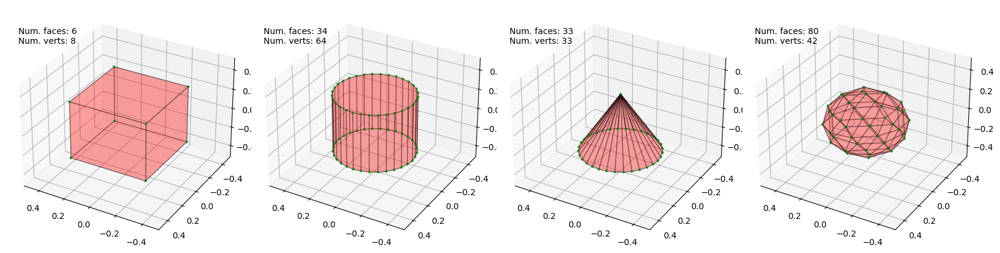

Step 340
Loss (vertices) 3.1730542182922363
Loss (faces) 2.120296001434326


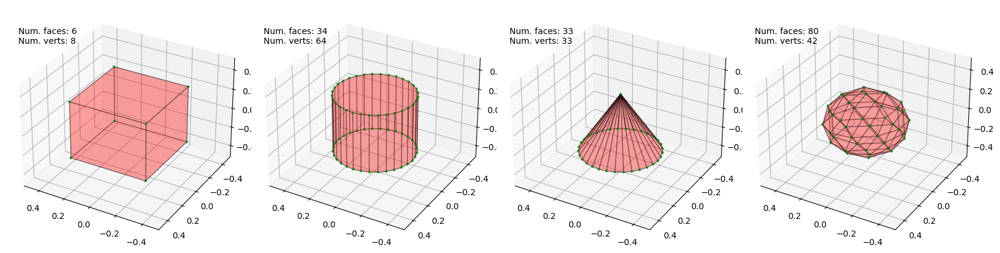

Step 345
Loss (vertices) 3.0883240699768066
Loss (faces) 2.049867630004883


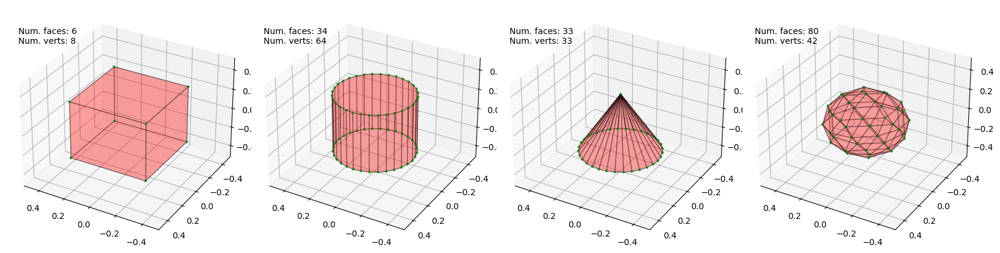

Step 350
Loss (vertices) 3.007763624191284
Loss (faces) 1.9833396673202515


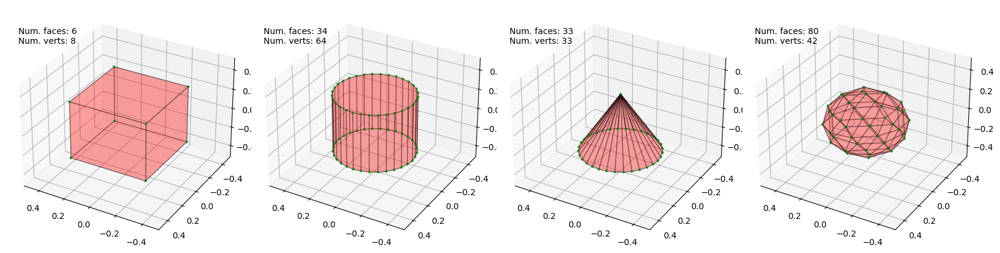

Step 355
Loss (vertices) 2.9304659366607666
Loss (faces) 1.9204121828079224


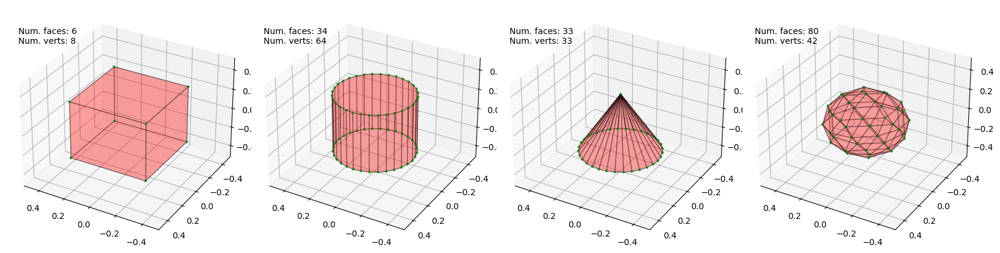

Step 360
Loss (vertices) 2.856985330581665
Loss (faces) 1.860832929611206


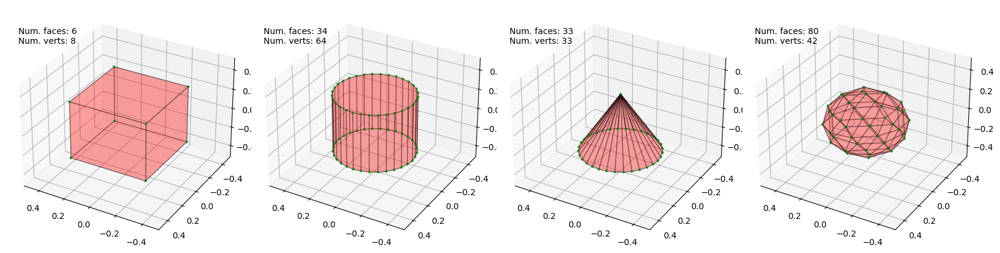

Step 365
Loss (vertices) 2.786078929901123
Loss (faces) 1.8043415546417236


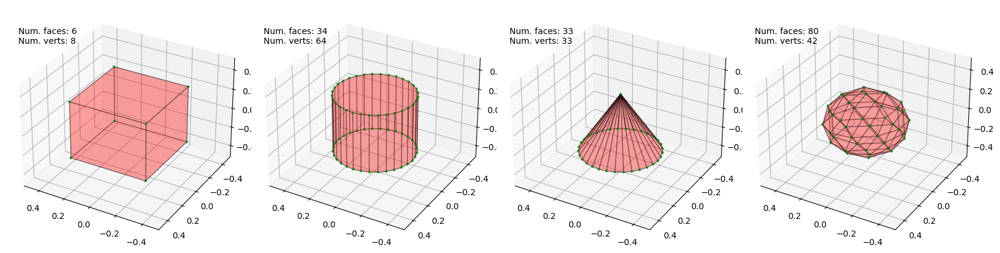

Step 370
Loss (vertices) 2.718453884124756
Loss (faces) 1.7507251501083374


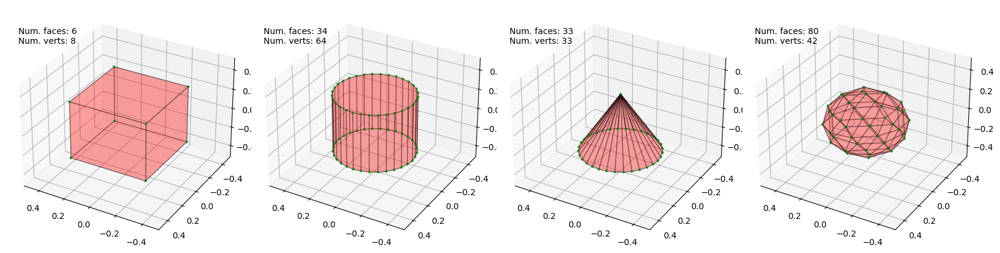

Step 375
Loss (vertices) 2.653538703918457
Loss (faces) 1.6997787952423096


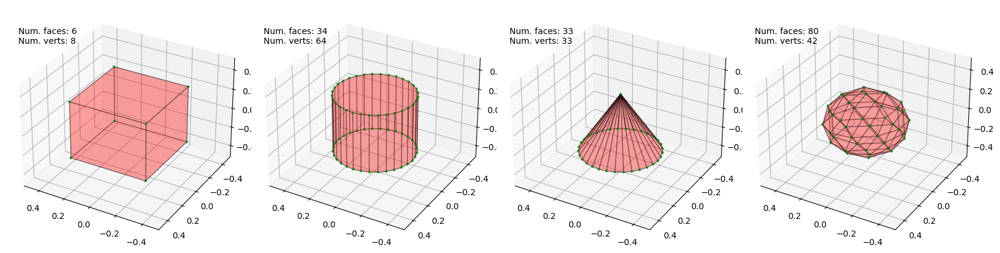

Step 380
Loss (vertices) 2.5912604331970215
Loss (faces) 1.6513042449951172


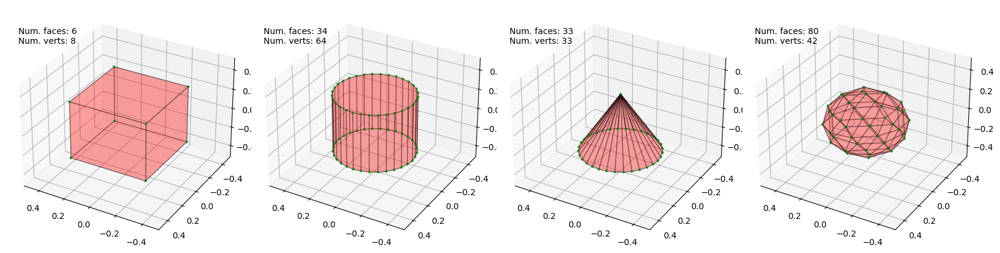

Step 385
Loss (vertices) 2.531338691711426
Loss (faces) 1.6051487922668457


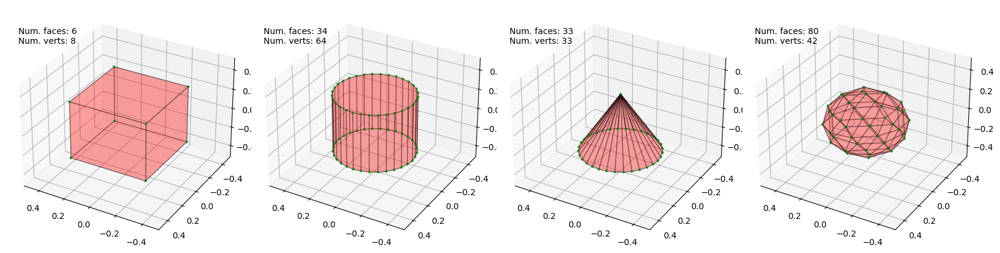

Step 390
Loss (vertices) 2.4736642837524414
Loss (faces) 1.5611443519592285


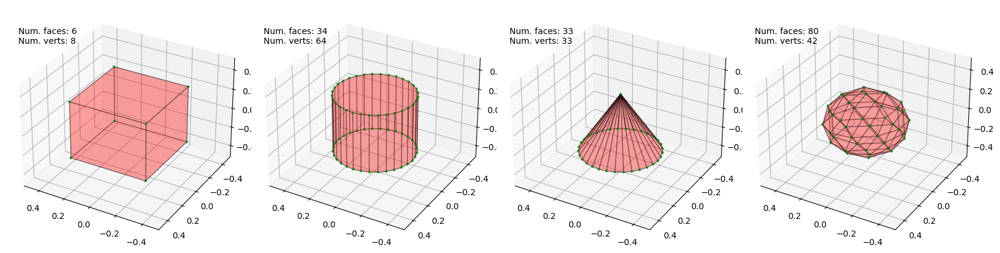

Step 395
Loss (vertices) 2.4182324409484863
Loss (faces) 1.51914644241333


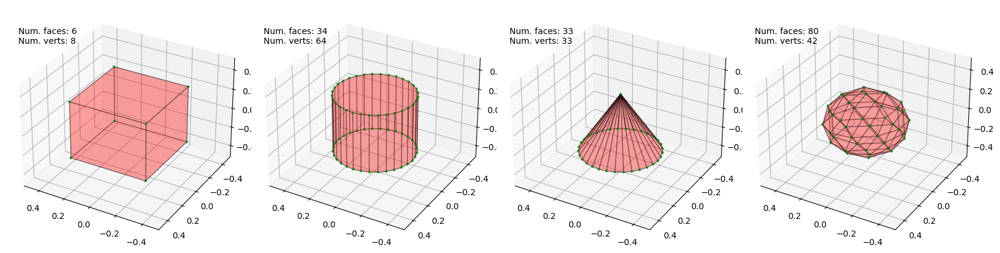

Step 400
Loss (vertices) 2.3649675846099854
Loss (faces) 1.479026198387146


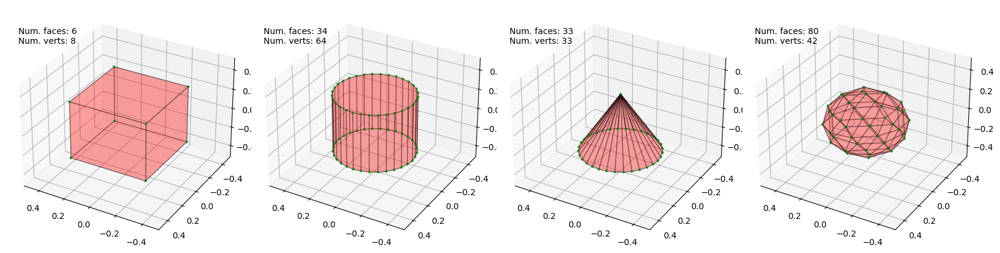

Step 405
Loss (vertices) 2.3137636184692383
Loss (faces) 1.440680980682373


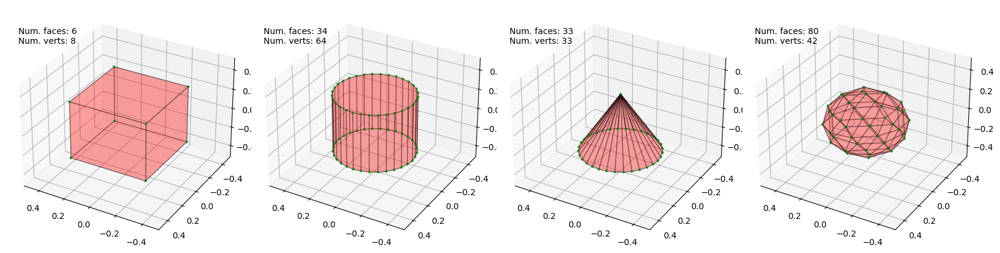

Step 410
Loss (vertices) 2.2642035484313965
Loss (faces) 1.4039876461029053


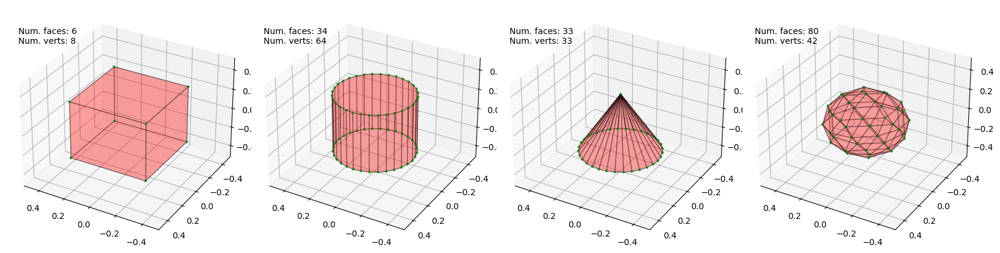

Step 415
Loss (vertices) 2.216472864151001
Loss (faces) 1.3688483238220215


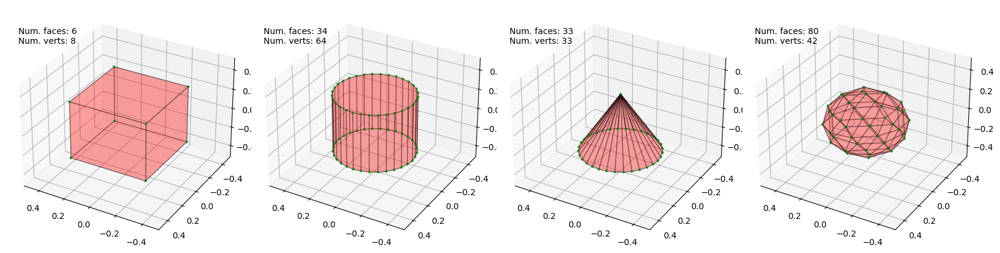

Step 420
Loss (vertices) 2.170546531677246
Loss (faces) 1.3351645469665527


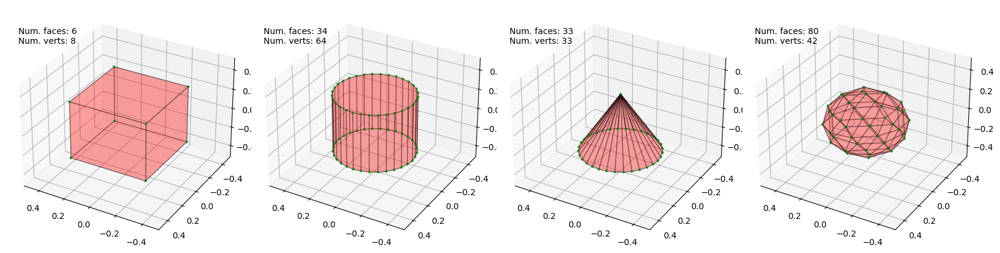

Step 425
Loss (vertices) 2.125880002975464
Loss (faces) 1.3028708696365356


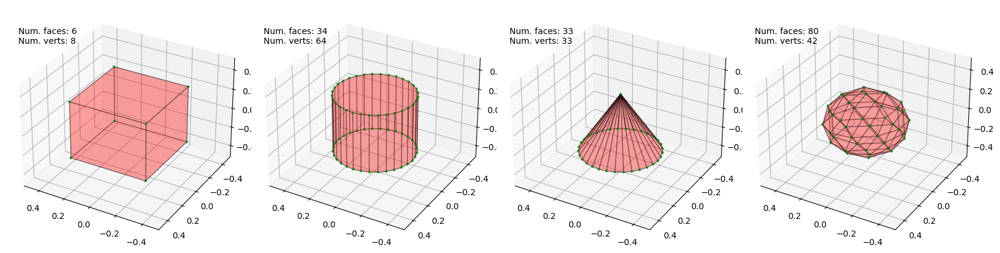

Step 430
Loss (vertices) 2.082890272140503
Loss (faces) 1.271864414215088


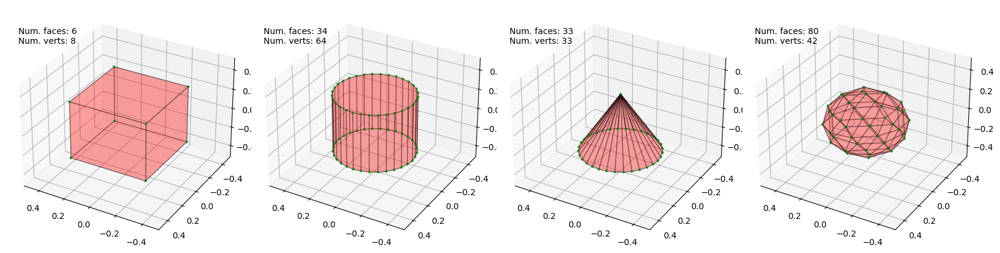

Step 435
Loss (vertices) 2.0413804054260254
Loss (faces) 1.242081642150879


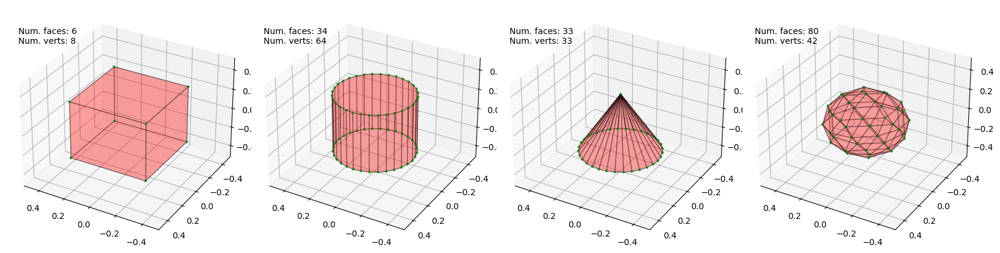

Step 440
Loss (vertices) 2.0011870861053467
Loss (faces) 1.2134474515914917


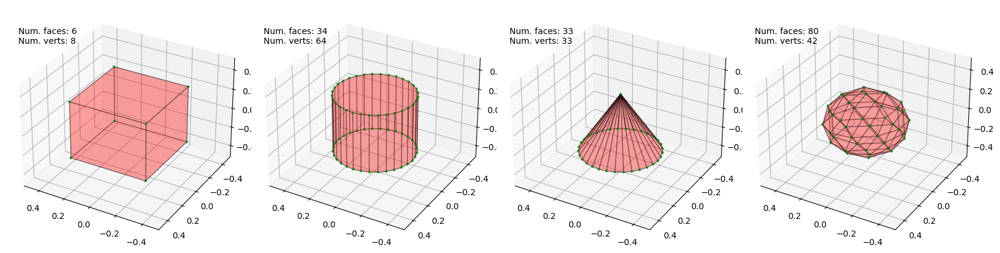

Step 445
Loss (vertices) 1.962494134902954
Loss (faces) 1.1859015226364136


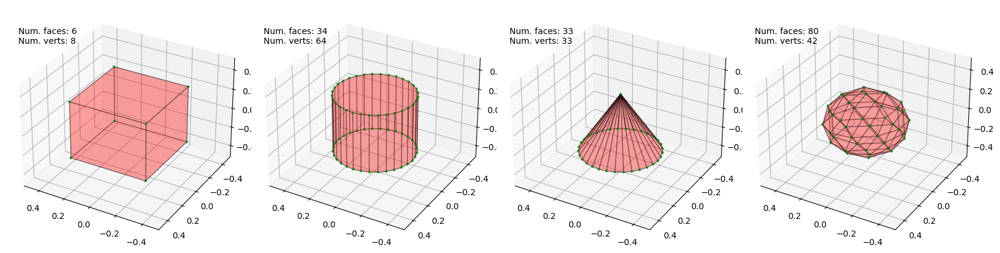

Step 450
Loss (vertices) 1.9246456623077393
Loss (faces) 1.1594021320343018


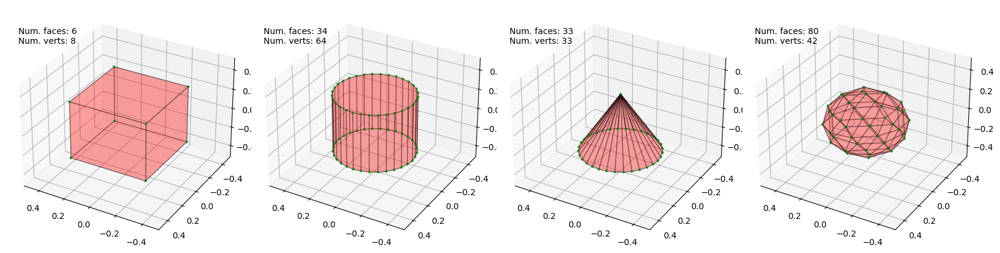

Step 455
Loss (vertices) 1.8882123231887817
Loss (faces) 1.1338763236999512


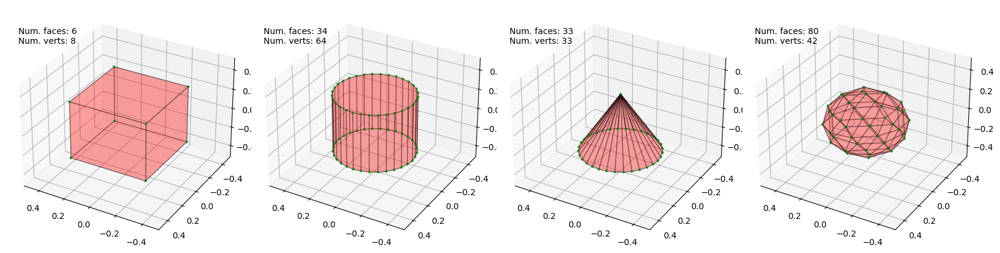

Step 460
Loss (vertices) 1.853022813796997
Loss (faces) 1.1092628240585327


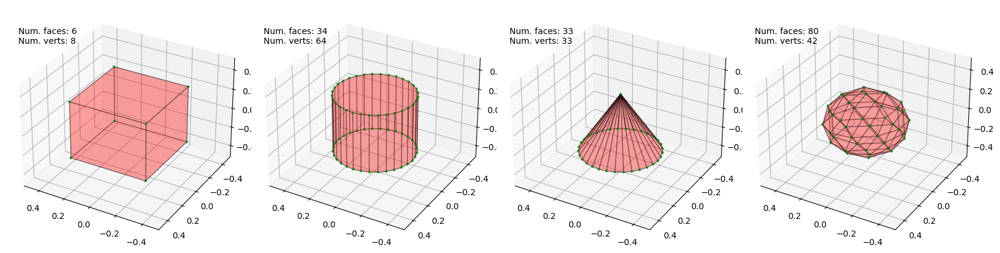

Step 465
Loss (vertices) 1.818832516670227
Loss (faces) 1.085537314414978


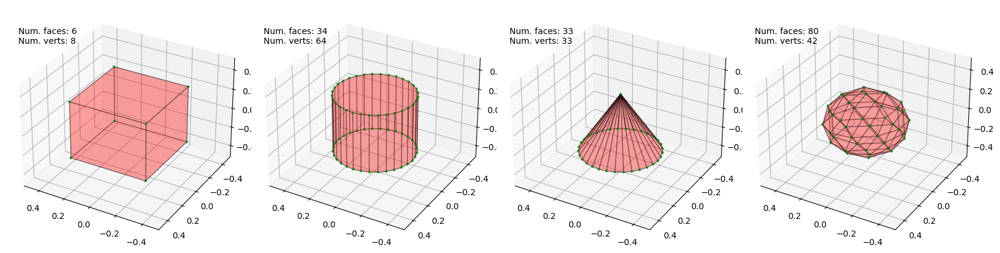

Step 470
Loss (vertices) 1.78561270236969
Loss (faces) 1.0626384019851685


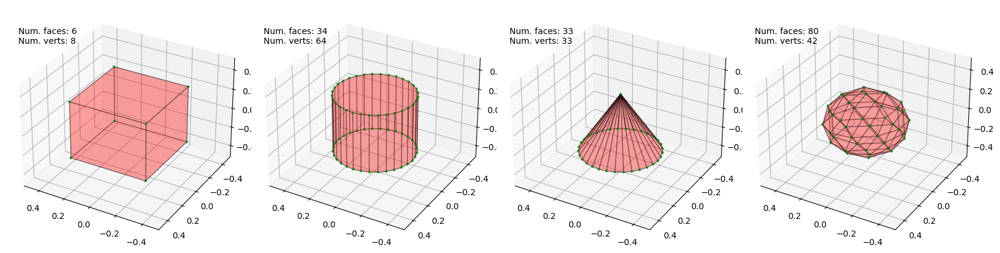

Step 475
Loss (vertices) 1.753516674041748
Loss (faces) 1.0405412912368774


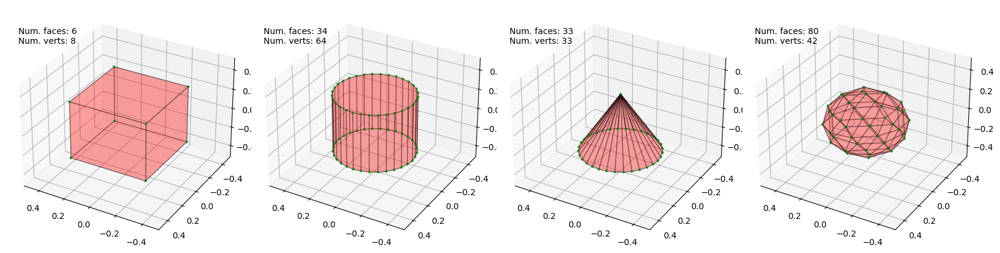

Step 480
Loss (vertices) 1.722324013710022
Loss (faces) 1.0191909074783325


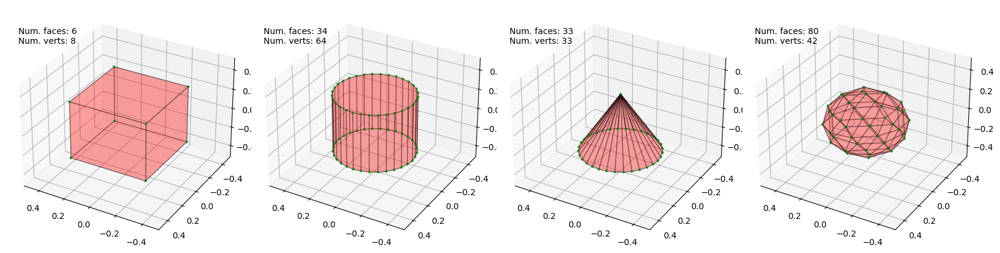

Step 485
Loss (vertices) 1.6920452117919922
Loss (faces) 0.9985618591308594


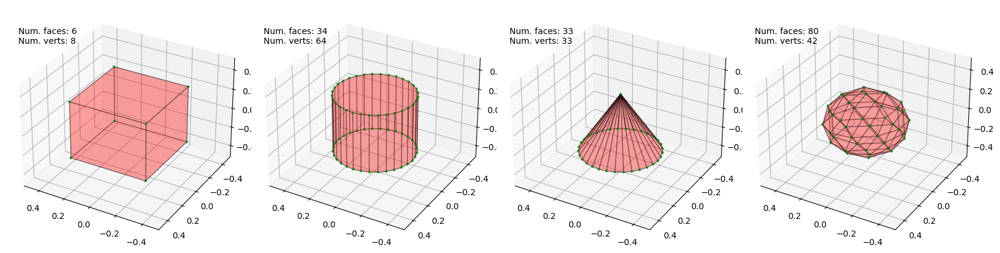

Step 490
Loss (vertices) 1.6625983715057373
Loss (faces) 0.9786179065704346


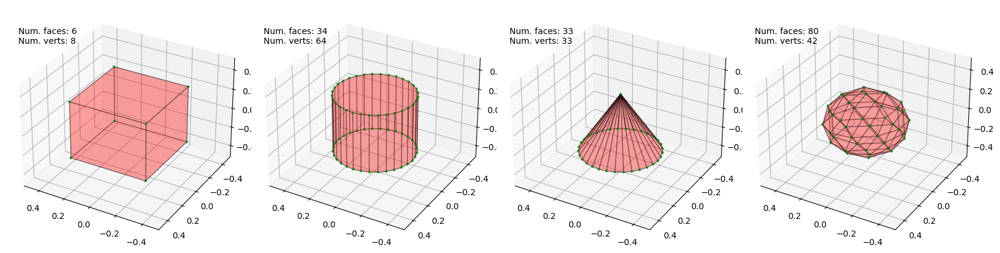

Step 495
Loss (vertices) 1.6337189674377441
Loss (faces) 0.959321916103363


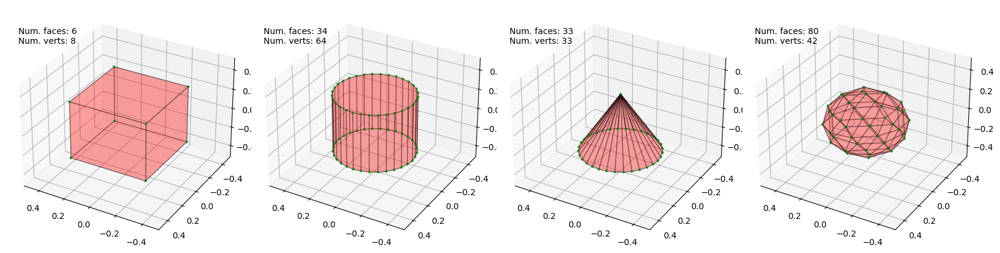

In [6]:
# Optimization settings
learning_rate = 5e-4
training_steps = 500
check_step = 5

# Create an optimizer an minimize the summed log probability of the mesh 
# sequences
optimizer = tf.train.AdamOptimizer(learning_rate)
vertex_model_optim_op = optimizer.minimize(vertex_model_loss)
face_model_optim_op = optimizer.minimize(face_model_loss)

# Training loop
with tf.Session() as sess:
  sess.run(tf.global_variables_initializer())
  for n in range(training_steps):
    if n % check_step == 0:
      v_loss, f_loss = sess.run((vertex_model_loss, face_model_loss))
      print('Step {}'.format(n))
      print('Loss (vertices) {}'.format(v_loss))
      print('Loss (faces) {}'.format(f_loss))
      v_samples_np, f_samples_np, b_np = sess.run(
        (vertex_samples, face_samples, vertex_model_batch))
      mesh_list = []
      for n in range(4):
        mesh_list.append(
            {
                'vertices': v_samples_np['vertices'][n][:v_samples_np['num_vertices'][n]],
                'faces': data_utils.unflatten_faces(
                    f_samples_np['faces'][n][:f_samples_np['num_face_indices'][n]])
            }
        )
      data_utils.plot_meshes(mesh_list, ax_lims=0.5)
    sess.run((vertex_model_optim_op, face_model_optim_op))